# Multi-satellite position control
Copyright (c) 2010-2022, Delft University of Technology. All rights reserved. This file is part of the Tudat. Redistribution and use in source and binary forms, with or without modification, are permitted exclusively under the terms of the Modified BSD license. You should have received a copy of the license with this file. If not, please or visit: http://tudat.tudelft.nl/LICENSE.

## Context
This example tries to control a small fleet of satellites.

## Import statements
The required import statements are made here, at the very beginning.

Some standard modules are first loaded: `numpy` and `matplotlib.pyplot`.

Then, the different modules of `tudatpy` that will be used are imported.

In [1]:
# Load standard modules
import numpy as np
from matplotlib import pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import mpl_toolkits.mplot3d.axes3d as p3

# Load tudatpy modules
from tudatpy.kernel.interface import spice
from tudatpy.kernel import numerical_simulation
from tudatpy.kernel.numerical_simulation import environment, environment_setup, propagation_setup
from tudatpy.kernel.astro import element_conversion, frame_conversion
from tudatpy.kernel import constants
from tudatpy.util import result2array

## Configuration
NAIF's `SPICE` kernels are first loaded, so that the position of various bodies such as the Earth can be make known to `tudatpy`.

Then, the start and end simulation epochs are setups. In this case, the start epoch is set to `0`, corresponding to the 1st of January 2000.
The end epoch is defined as 1 day later.
The times should be specified in seconds since J2000.
Please refer to the API documentation of the `time_conversion module` [here](https://tudatpy.readthedocs.io/en/latest/time_conversion.html) for more information on this.

In [84]:
# Load spice kernels
spice.load_standard_kernels()

# Set simulation start and end epochs
simulation_length = 0.5 # [days]
simulation_start_epoch = 0.0
simulation_end_epoch = simulation_start_epoch + simulation_length * constants.JULIAN_DAY

## Environment setup
Let’s create the environment for our simulation. This setup covers the creation of (celestial) bodies, vehicle(s), and environment interfaces.

### Create the bodies
Bodies can be created by making a list of strings with the bodies that is to be included in the simulation.

The default body settings (such as atmosphere, body shape, rotation model) are taken from `SPICE`.

These settings can be adjusted. Please refere to the [Available Environment Models](https://tudat-space.readthedocs.io/en/latest/_src_user_guide/state_propagation/environment_setup/create_models/available.html#available-environment-models) in the user guide for more details.

Finally, the system of bodies is created using the settings. This system of bodies is stored into the variable `bodies`.

In [85]:
# Create default body settings for "Earth"
bodies_to_create = ["Earth"]

# Create default body settings for bodies_to_create, with "Earth"/"J2000" as the global frame origin and orientation
global_frame_origin = "Earth"
global_frame_orientation = "J2000"
body_settings = environment_setup.get_default_body_settings(
    bodies_to_create, global_frame_origin, global_frame_orientation)

# Create system of bodies (in this case only Earth)
bodies = environment_setup.create_system_of_bodies(body_settings)

### Create the vehicles
Let's now create the satellites for which the orbit around Earth will be propagated.

In [86]:
# Add vehicle object to system of bodies
number_of_satellites = 3
satellite_name_list = []
initial_mass = 400.0
inertia_tensor = 0.01 * np.eye(3)

for i in range(number_of_satellites):
    satellite_name = f"Satellite_{i}"
    satellite_name_list.append(satellite_name)
    bodies.create_empty_body(satellite_name)
    bodies.get(satellite_name).mass = initial_mass
    bodies.get(satellite_name).inertia_tensor = inertia_tensor

## Propagation setup
Now that the environment is created, the propagation setup is defined.

First, the bodies to be propagated and the central bodies will be defined.
Central bodies are the bodies with respect to which the state of the respective propagated bodies is defined.

In [87]:
# Define bodies that are propagated
bodies_to_propagate = satellite_name_list

# Define central bodies of propagation
central_bodies = number_of_satellites * ["Earth"]

### Creating a force

Create a force in an arbitrary direction

In [88]:
class thrust_model:

    def __init__(self, control_input, control_timestep, Isp, propagated_body):
        self.control_input = control_input       # Control input in xyz direction over time (numpy.ndarray[3, number_of_inputs]) in RSW frame [N]
        self.control_timestep = control_timestep # Length between different control signals [s]
        self.Isp = Isp                           # Specific impulse [s]
        self.propagated_body = propagated_body   # Body that is being propagated (tudatpy.numerical_simulation.environment.Body)
        self.t0 = None
        self.number_of_inputs = len(self.control_input[0,:])
        
        self.control_magnitudes = np.zeros(self.number_of_inputs)
        self.control_direction = np.zeros_like(self.control_input)
        self.find_magnitude_and_direction()
        
    def find_magnitude_and_direction(self):
        # Use norm for the magnitudes
        self.control_magnitudes = np.linalg.norm(self.control_input, axis=0)
        
        # Direction is easy for values where magnitude is not 0
        non_zero_magnitudes = self.control_magnitudes > 0.00000001
        self.control_direction[:, non_zero_magnitudes] = self.control_input[:, non_zero_magnitudes] / self.control_magnitudes[non_zero_magnitudes]
        self.control_direction[:, ~non_zero_magnitudes] = np.array([[1, 0, 0]]).T # Use x-axis for direction with zero maginitude
        
        
    def get_thrust_magnitude(self, time):
        if np.isnan(time):
            return 0 # Check if this is allowed! -> Seems to be. Changing to 100 does not affect result
        else:
            if self.t0 is None:
                self.t0 = time

            idx = int( (time-self.t0) / control_timestep)
            if idx < self.number_of_inputs:
                return self.control_magnitudes[idx]
            else:
                raise Exception(f"No control input available for time {time} s. Simulation started at {self.t0} s.")
        
    def get_specific_impulse(self, time):
        # Return the constant specific impulse
        return self.Isp

    def get_thrust_direction(self, time):
        if np.isnan(time):
            return np.array([1, 0, 0])
        else:
            if self.t0 is None:
                self.t0 = time

            idx = int( (time-self.t0) / control_timestep)
            if idx < self.number_of_inputs:
                # Find force in RSW frame
                thrust_direction_RSW_frame = self.control_direction[:, idx]

                # Find rotation matrix from RSW to inertial frame
                current_state = self.propagated_body.state
                RSW_to_inertial_frame = frame_conversion.rsw_to_inertial_rotation_matrix(current_state)

                # Compute the thrust in the inertial frame
                thrust_inertial_frame = np.dot(RSW_to_inertial_frame, thrust_direction_RSW_frame)

                # Return the thrust direction in the inertial frame
                return thrust_inertial_frame
            else:
                raise Exception(f"No control input available for time {time} s. Simulation started at {self.t0} s.")

In [89]:
def create_body_settings_for_thrust(current_thrust_model, bodies, body_name):
    # Define the thrust direction settings for the satellite from the custom direction function
    rotation_model_settings = environment_setup.rotation_model.custom_inertial_direction_based(current_thrust_model.get_thrust_direction, "J2000", "VehicleFixed")  
    environment_setup.add_rotation_model( bodies, body_name, rotation_model_settings)


    # Define the thrust magnitude settings for the satellite from the custom functions
    thrust_magnitude_settings = propagation_setup.thrust.custom_thrust_magnitude(current_thrust_model.get_thrust_magnitude, current_thrust_model.get_specific_impulse)
    
    environment_setup.add_engine_model(body_name, body_name+"_engine", thrust_magnitude_settings, bodies)

In [100]:
# Define a specific impulse constant
specific_impulse = 1E9 # Really high to make mass constant

control_timestep = 10 # [s]
control_horizon = int((simulation_end_epoch - simulation_start_epoch) / control_timestep)
control_inputs = np.zeros((number_of_satellites, 3, control_horizon))
control_inputs[0][1] = 10

for idx, satellite_name in enumerate(satellite_name_list):
    # Setup the thrust model for the satellite
    current_thrust_model = thrust_model(control_inputs[idx], control_timestep, specific_impulse, bodies.get(satellite_name))
    create_body_settings_for_thrust(current_thrust_model, bodies, satellite_name)

### Create the acceleration model
First off, the acceleration settings that act on the satellites are to be defined.
In this case, these simply consist in the Earth gravitational effect modelled as a point mass.

The acceleration settings defined are then applied to satellites in a dictionary.

This dictionary is finally input to the propagation setup to create the acceleration models.

In [101]:
acceleration_settings = dict()

for satellite_name in satellite_name_list:
    # Define accelerations acting on a single satellite
    acceleration_settings_satellite = {
        "Earth" : [propagation_setup.acceleration.point_mass_gravity()],
        satellite_name : [propagation_setup.acceleration.thrust_from_all_engines()]
    }

    acceleration_settings[satellite_name] = acceleration_settings_satellite

# Create acceleration models
acceleration_models = propagation_setup.create_acceleration_models(
    bodies, acceleration_settings, bodies_to_propagate, central_bodies
)

### Create a mass model
Create a mass model to deal with the mass physics

In [102]:
mass_rate_settings = dict()

for satellite_name in satellite_name_list:
    mass_rate_settings[satellite_name] =  [propagation_setup.mass_rate.from_thrust()]
    
mass_rate_models = propagation_setup.create_mass_rate_models(
    bodies,
    mass_rate_settings,
    acceleration_models
)

### Define the initial state
The initial state of the vehicle that will be propagated is now defined. 

This initial state always has to be provided as a cartesian state, in the form of a list with the first three elements reprensenting the initial position, and the three remaining elements representing the initial velocity.

In this case, let's make use of the `keplerian_to_cartesian_elementwise()` function that is included in the `element_conversion` module, so that the initial state can be input as Keplerian elements, and then converted in Cartesian elements.

In [103]:
# Set initial conditions for the satellite that will be
# propagated in this simulation. The initial conditions are given in
# Keplerian elements and later on converted to Cartesian elements

# Retrieve gravitational parameter
earth_gravitational_parameter = bodies.get("Earth").gravitational_parameter
# Retrieve Earth's radius
earth_radius = bodies.get("Earth").shape_model.average_radius

orbit_semi_major_axis=earth_radius+750e3 # [m]
orbit_eccentricity=0.0
orbit_inclination=np.deg2rad(0)
orbit_argument_of_periapsis=np.deg2rad(0)
orbit_longitude_of_ascending_node=np.deg2rad(0)

true_anomalies = np.deg2rad([0, 0, 0])

initial_states = np.array([])

for satellite in range(number_of_satellites):
    initial_states = np.append(initial_states, 
        element_conversion.keplerian_to_cartesian_elementwise(
            gravitational_parameter=earth_gravitational_parameter,
            semi_major_axis=orbit_semi_major_axis,
            eccentricity=orbit_eccentricity,
            inclination=orbit_inclination,
            argument_of_periapsis=orbit_argument_of_periapsis,
            longitude_of_ascending_node=orbit_longitude_of_ascending_node,
            true_anomaly=true_anomalies[satellite]
        )
    )

### Create the propagator settings
The propagator is finally setup.

First, a termination condition is defined so that the propagation will stop when the end epochs that was defined is reached.

Subsequently, the integrator settings are defined using a RK4 integrator with the fixed step size of 10 seconds.

Then, the translational propagator settings are defined. These are used to simulate the orbit of the satellites around Earth.

In [104]:
# Create termination settings
termination_settings = propagation_setup.propagator.time_termination(simulation_end_epoch)

# Create numerical integrator settings
fixed_step_size = 10.0
integrator_settings = propagation_setup.integrator.runge_kutta_4(fixed_step_size)

# Also save orbital elements
dependent_variables_to_save_trans = []

for satellite_name in satellite_name_list:
    dependent_variables_to_save_trans.extend([
        propagation_setup.dependent_variable.keplerian_state(satellite_name, "Earth"),
        propagation_setup.dependent_variable.single_acceleration(propagation_setup.acceleration.AvailableAcceleration.point_mass_gravity_type, satellite_name, "Earth"),
        # propagation_setup.dependent_variable.single_acceleration(propagation_setup.acceleration.AvailableAcceleration.thrust_acceleration_type, satellite_name, satellite_name)
    ])

# Create propagation settings translational part
translational_propagator_settings = propagation_setup.propagator.translational(
    central_bodies,
    acceleration_models,
    bodies_to_propagate,
    initial_states,
    simulation_start_epoch,
    integrator_settings,
    termination_settings,
    output_variables=dependent_variables_to_save_trans
)

# Create propagation settings for the mass
dependent_variables_to_save_mass = []
for satellite_name in satellite_name_list:
    dependent_variables_to_save_trans.extend([propagation_setup.dependent_variable.body_mass(satellite_name)])
    
mass_propagator_settings = propagation_setup.propagator.mass(
    bodies_to_propagate,
    mass_rate_models,
    number_of_satellites * [initial_mass],
    simulation_start_epoch,
    integrator_settings,
    termination_settings,
    output_variables=dependent_variables_to_save_mass)

propagator_settings_list =[translational_propagator_settings, mass_propagator_settings]

# Define settings for multi-type propagator
propagator_settings = propagation_setup.propagator.multitype(
    propagator_settings_list,
    integrator_settings,
    simulation_start_epoch,
    termination_settings,
    output_variables =  dependent_variables_to_save_trans+dependent_variables_to_save_mass)

## Propagate the orbit
The orbit is now ready to be propagated.

This is done by calling the `create_dynamics_simulator()` function of the `numerical_simulation module`.
This function requires the `bodies` and `propagator_settings` that have all been defined earlier.

After this, the history of the propagated state over time, containing both the position and velocity history, is extracted.
This history, taking the form of a dictionary, is then converted to an array containing 7 columns:
- Column 0: Time history, in seconds since J2000.
- Columns 1 to 3: Position history, in meters, in the frame that was specified in the `body_settings`.
- Columns 4 to 6: Velocity history, in meters per second, in the frame that was specified in the `body_settings`.

In [105]:
# Create simulation object and propagate the dynamics
dynamics_simulator = numerical_simulation.create_dynamics_simulator(
    bodies, propagator_settings
)

# Extract the resulting state history and convert it to an ndarray
states = dynamics_simulator.state_history
states_array = result2array(states)
print(states_array.shape)

# For the orbital elements
dep_vars = dynamics_simulator.dependent_variable_history
dep_vars_array = result2array(dep_vars)
print(dep_vars_array.shape)

(4320, 22)
(4320, 31)


## Post-process the propagation results
The results of the propagation are then processed to a more user-friendly form.

### Print initial and final states
First, let's print the initial and final position and velocity vector of a satellite.

In [106]:
print(
    f"""
Single Earth-Orbiting Satellite Example.
The initial position vector of {satellite_name_list[0]} is [km]: \n{
    states_array[0, :3] / 1E3} 
The initial velocity vector of {satellite_name_list[0]} is [km/s]: \n{
    states_array[0, 3:6] / 1E3}
\nAfter {simulation_end_epoch-simulation_start_epoch} seconds the position vector of {satellite_name_list[0]} is [km]: \n{
    states_array[-1, :3] / 1E3}
And the velocity vector of {satellite_name_list[0]} is [km/s]: \n{
    states_array[-1, 3:6] / 1E3}
    """
)

print(np.linalg.norm(states_array[-1, :3] / 1E3))


Single Earth-Orbiting Satellite Example.
The initial position vector of Satellite_0 is [km]: 
[   0.         7121.00836667    0.        ] 
The initial velocity vector of Satellite_0 is [km/s]: 
[ 0.         -0.          7.48166296]

After 43200.0 seconds the position vector of Satellite_0 is [km]: 
[   43.19        3399.11341002 -9158.83178971]
And the velocity vector of Satellite_0 is [km/s]: 
[0.         5.99763294 2.15640288]
    
9769.341692383688


### Visualise the trajectory
Finally, let's plot the trajectory of the satellites around Earth in 3D.

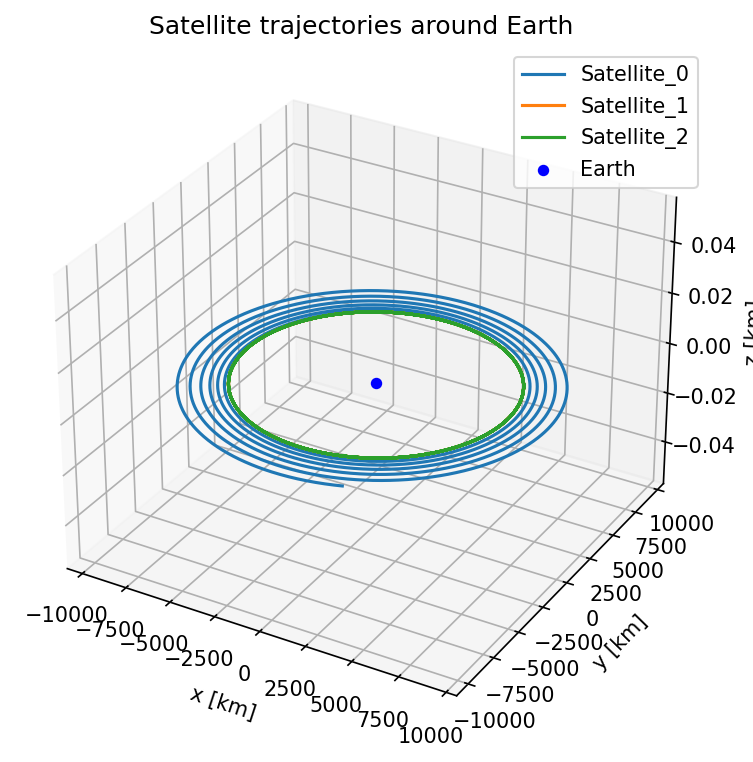

In [107]:
# Define a 3D figure using pyplot
fig = plt.figure(figsize=(6,6), dpi=150)
ax = fig.add_subplot(111, projection='3d')
ax.set_title(f'Satellite trajectories around Earth')

# Plot the positional state history
for satellite in range(number_of_satellites):
    ax.plot(states_array[:, satellite*6+1]/1E3, states_array[:, satellite*6+2]/1E3, states_array[:, satellite*6+3]/1E3, label=bodies_to_propagate[satellite], linestyle='-')
    
ax.scatter(0.0, 0.0, 0.0, label="Earth", marker='o', color='blue')

# Add the legend and labels, then show the plot
ax.legend()
ax.set_xlabel('x [km]')
ax.set_ylabel('y [km]')
ax.set_zlabel('z [km]')
plt.show()

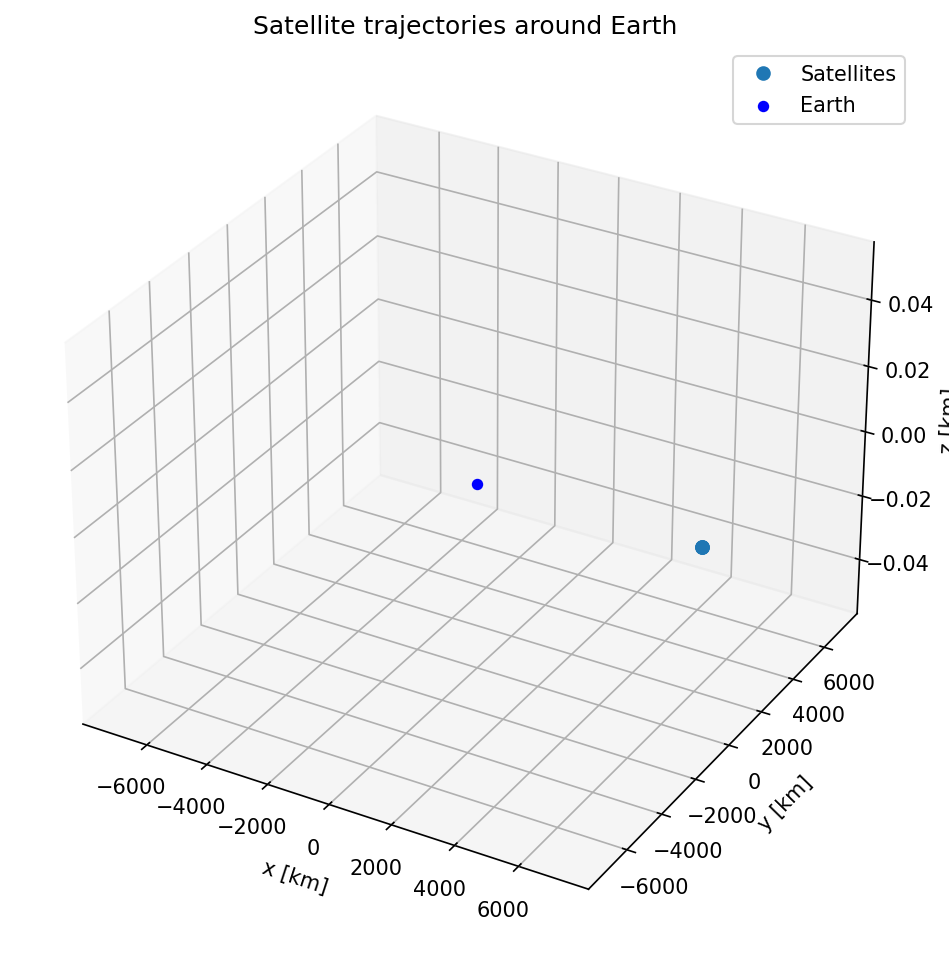

In [108]:
# Define a 3D figure using pyplot
fig = plt.figure(figsize=(6,6), dpi=150)
ax = p3.Axes3D(fig, auto_add_to_figure=False) # 3D place for drawing
fig.add_axes(ax)
ax.set_title(f'Satellite trajectories around Earth')

# Plot the positional state history
idx_base = np.linspace(0, number_of_satellites, number_of_satellites, endpoint=False, dtype=int) * 6
pos, = ax.plot(states_array[0, idx_base+1]/1E3, states_array[0, idx_base+2]/1E3, states_array[0, idx_base+3]/1E3, 'o', label="Satellites")
ax.scatter(0.0, 0.0, 0.0, label="Earth", marker='o', color='blue')

# Add the legend and labels, then show the plot
ax.legend()
ax.set_xlabel('x [km]')
ax.set_ylabel('y [km]')
ax.set_zlabel('z [km]')
ax.set_xlim([-orbit_semi_major_axis/1e3*1.1, orbit_semi_major_axis/1e3*1.1])
ax.set_ylim([-orbit_semi_major_axis/1e3*1.1, orbit_semi_major_axis/1e3*1.1])

def animation_function(i):
    pos.set_xdata(states_array[i, idx_base+1]/1E3)
    pos.set_ydata(states_array[i, idx_base+2]/1E3)
    pos.set_3d_properties(states_array[i, idx_base+3]/1E3)
    return pos,
  
animation = FuncAnimation(fig,
                          func = animation_function,
                          frames = np.linspace(1, len(states_array[:, 0]), int(len(states_array[:, 0])/50), endpoint=False, dtype=int), 
                          interval = 100,
                          repeat=True,
                          blit=False)

# plt.show()

HTML(animation.to_jshtml())

### Keplerian elements

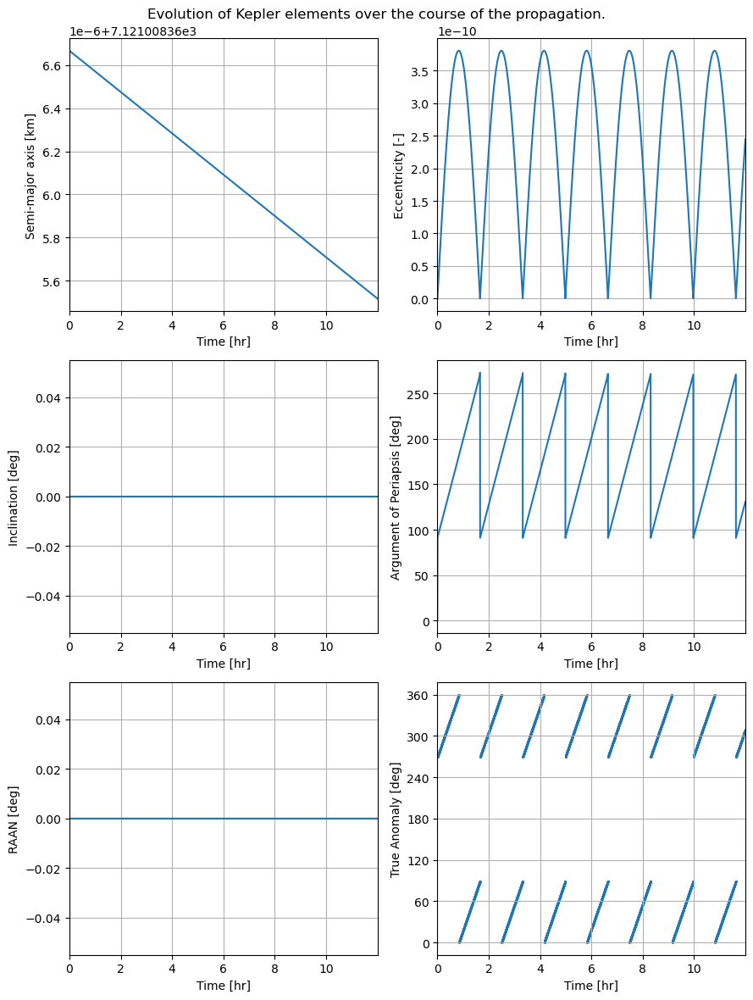

In [111]:
# Plot Kepler elements as a function of time
time_hours = dep_vars_array[:,0]/3600
kepler_elements = dep_vars_array[:,10:16]
fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6)) = plt.subplots(3, 2, figsize=(9, 12))
fig.suptitle('Evolution of Kepler elements over the course of the propagation.')

# Semi-major Axis
semi_major_axis = kepler_elements[:,0] / 1e3
ax1.plot(time_hours, semi_major_axis)
ax1.set_ylabel('Semi-major axis [km]')

# Eccentricity
eccentricity = kepler_elements[:,1]
ax2.plot(time_hours, eccentricity)
ax2.set_ylabel('Eccentricity [-]')

# Inclination
inclination = np.rad2deg(kepler_elements[:,2])
ax3.plot(time_hours, inclination)
ax3.set_ylabel('Inclination [deg]')

# Argument of Periapsis
argument_of_periapsis = np.rad2deg(kepler_elements[:,3])
ax4.plot(time_hours, argument_of_periapsis)
ax4.set_ylabel('Argument of Periapsis [deg]')

# Right Ascension of the Ascending Node
raan = np.rad2deg(kepler_elements[:,4])
ax5.plot(time_hours, raan)
ax5.set_ylabel('RAAN [deg]')

# True Anomaly
true_anomaly = np.rad2deg(kepler_elements[:,5])
ax6.scatter(time_hours, true_anomaly, s=1)
ax6.set_ylabel('True Anomaly [deg]')
ax6.set_yticks(np.arange(0, 361, step=60))

for ax in fig.get_axes():
    ax.set_xlabel('Time [hr]')
    ax.set_xlim([min(time_hours), max(time_hours)])
    ax.grid()
plt.tight_layout()

### Force input

[2834.50966823 2834.50966823 2834.50966823 ... 2834.50967069 2834.50967069
 2834.5096707 ]


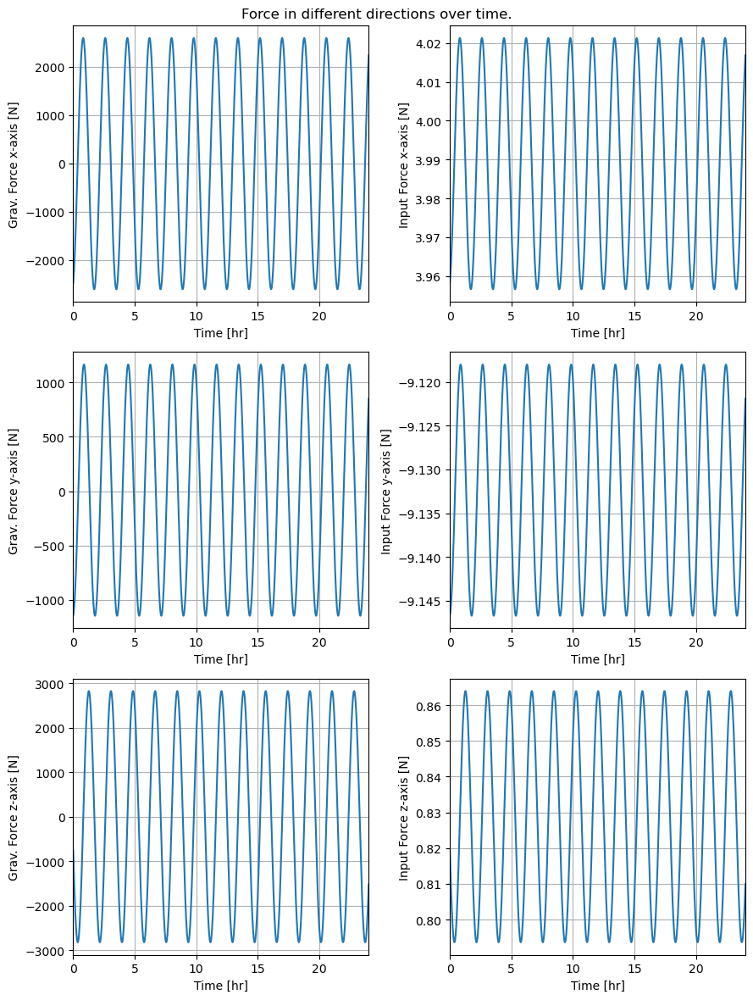

In [17]:
forces = dep_vars_array[:,7:13]*initial_mass
fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6)) = plt.subplots(3, 2, figsize=(9, 12))
fig.suptitle('Force in different directions over time.')

# X-axis grav
force_x = forces[:,0]
ax1.plot(time_hours, force_x)
ax1.set_ylabel('Grav. Force x-axis [N]')

# Y-axis grav
force_y = forces[:,1]
ax3.plot(time_hours, force_y)
ax3.set_ylabel('Grav. Force y-axis [N]')

# Z-axis grav
force_z = forces[:,2]
ax5.plot(time_hours, force_z)
ax5.set_ylabel('Grav. Force z-axis [N]')

# X-axis input
force_x = forces[:,3]
ax2.plot(time_hours, force_x)
ax2.set_ylabel('Input Force x-axis [N]')

# Y-axis input
force_y = forces[:,4]
ax4.plot(time_hours, force_y)
ax4.set_ylabel('Input Force y-axis [N]')

# Z-axis input
force_z = forces[:,5]
ax6.plot(time_hours, force_z)
ax6.set_ylabel('Input Force z-axis [N]')

for ax in fig.get_axes():
    ax.set_xlabel('Time [hr]')
    ax.set_xlim([min(time_hours), max(time_hours)])
    ax.grid()
plt.tight_layout()

print(np.linalg.norm(forces, axis=1))

### Mass

Plot the evolution of the mass over time

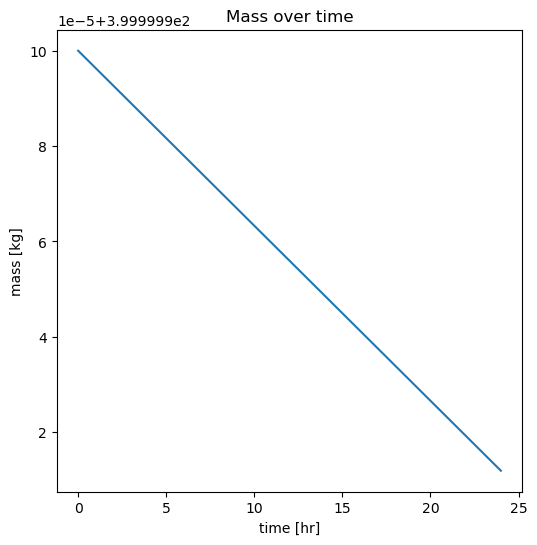

In [18]:
# Define a 3D figure using pyplot
fig = plt.figure(figsize=(6,6), dpi=100)
ax = fig.add_subplot(111)
ax.set_title(f'Mass over time')

# Plot the positional state history
ax.plot(time_hours, dep_vars_array[:, -1])

# Add the legend and labels, then show the plot
# ax.legend()
ax.set_xlabel('time [hr]')
ax.set_ylabel('mass [kg]')
plt.show()

In [19]:
print(dep_vars_array[0,:])

[ 0.00000000e+00  7.50000000e+06  2.83052443e-16  1.48876585e+00
  0.00000000e+00  4.08407045e-01  2.71747765e-01 -6.20286990e+00
 -2.85403971e+00 -1.89565793e+00  9.89531090e-03 -2.28667143e-02
  2.04846272e-03  1.71932423e-24  4.00000000e+02]
